# Importing Important libraries/datasets

In [1]:
!pip install jupyterthemes

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model,load_model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.utils import plot_model
from IPython.display import display
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, LearningRateScheduler
import os
import PIL
from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)
# setting the style of the notebook to be monokai theme to ensure that we are able to see the x and y axes clearly

In [3]:
os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train')

['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

In [4]:
os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test')

['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

In [5]:
train = []
test = []

for i in os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train'):
  train_class = os.listdir(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train', i))
  train.extend(train_class)
  test_class = os.listdir(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test', i))
  test.extend(test_class)

print('Number of train images : {} \nNumber of test images : {}'.format(len(train), len(test)))

Number of train images : 14034 
Number of test images : 3000


In [6]:
train[:25]

['0.jpg',
 '10006.jpg',
 '1001.jpg',
 '10014.jpg',
 '10018.jpg',
 '10029.jpg',
 '10032.jpg',
 '10056.jpg',
 '1009.jpg',
 '10113.jpg',
 '1012.jpg',
 '10126.jpg',
 '10144.jpg',
 '10151.jpg',
 '10161.jpg',
 '10165.jpg',
 '10176.jpg',
 '10184.jpg',
 '10185.jpg',
 '10191.jpg',
 '10196.jpg',
 '10198.jpg',
 '10205.jpg',
 '10210.jpg',
 '10228.jpg']

In [7]:
test[:15]

['20057.jpg',
 '20060.jpg',
 '20061.jpg',
 '20064.jpg',
 '20073.jpg',
 '20074.jpg',
 '20078.jpg',
 '20083.jpg',
 '20094.jpg',
 '20096.jpg',
 '20113.jpg',
 '20131.jpg',
 '20140.jpg',
 '20177.jpg',
 '20186.jpg']

We have completed importing the dataset and required libraries

# DATA EXPLORATION AND DATA VISUALIZATION

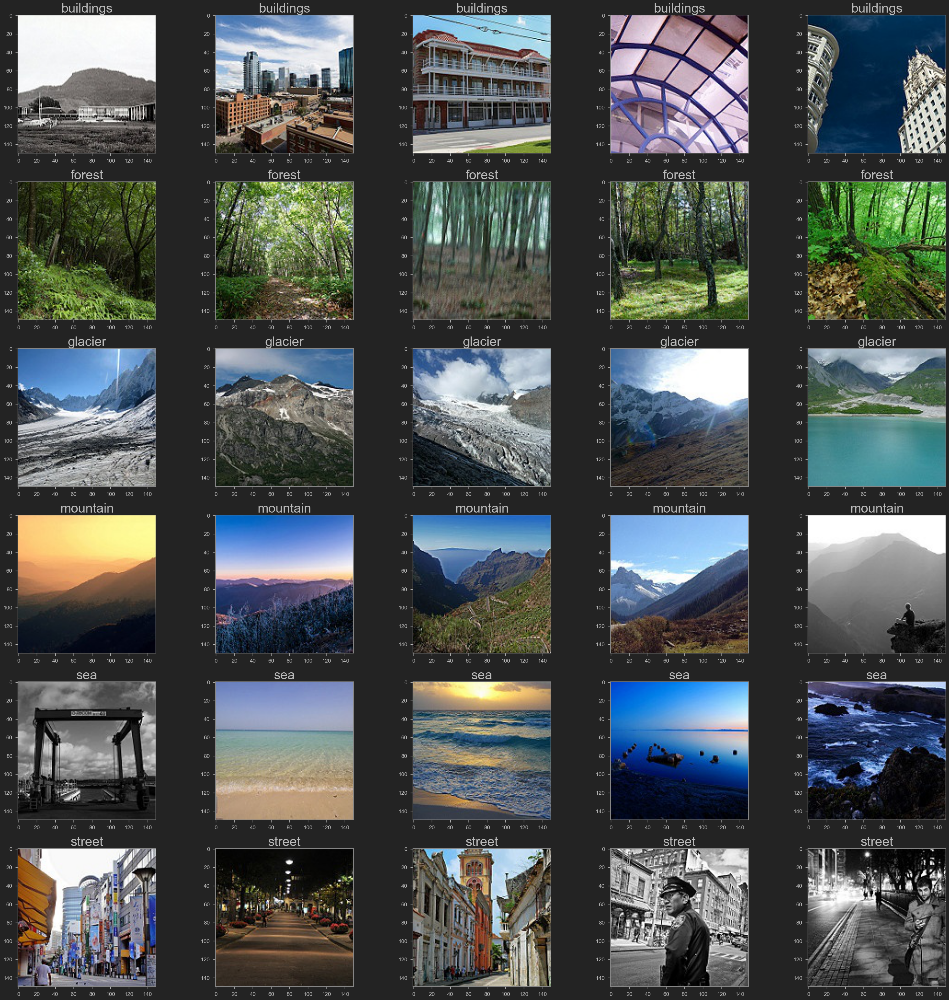

In [8]:
fig, axs = plt.subplots(6,5, figsize=(32,32))
count = 0
for i in os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train'):
  train_class = os.listdir(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train',i))
  for j in range(5):
    img = os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train', i, train_class[j])
    img = PIL.Image.open(img)
    axs[count][j].set_title(i, fontsize = 30)
    axs[count][j].imshow(img)  
  count += 1
fig.tight_layout()

In [9]:
No_images_per_class = []
Class_name = []
for i in os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train'):
  train_class = os.listdir(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train', i))
  No_images_per_class.append(len(train_class))
  Class_name.append(i)
  print('Number of images in {} = {} \n'.format(i, len(train_class)))

Number of images in buildings = 2191 

Number of images in forest = 2271 

Number of images in glacier = 2404 

Number of images in mountain = 2512 

Number of images in sea = 2274 

Number of images in street = 2382 



In [10]:
Class_name

['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

In [11]:
No_images_per_class

[2191, 2271, 2404, 2512, 2274, 2382]

<function matplotlib.pyplot.show(close=None, block=None)>

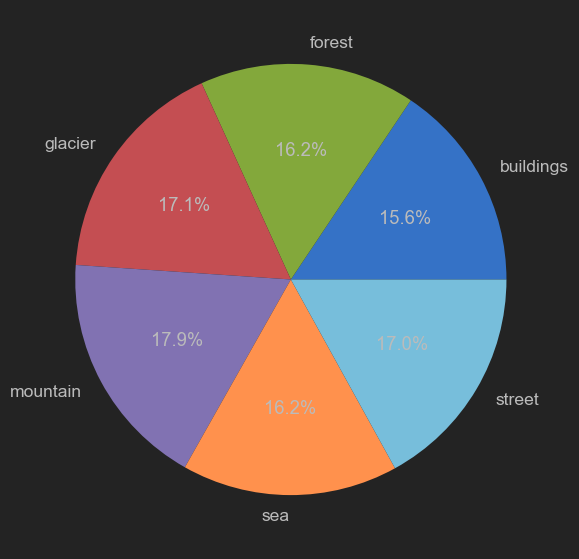

In [12]:
fig1, ax1 = plt.subplots()
ax1.pie(No_images_per_class, labels = Class_name, autopct = '%1.1f%%')
plt.show

In [13]:
No_images_per_class = []
Class_name1 = []
for i in os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test'):
  test_class = os.listdir(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test', i))
  No_images_per_class.append(len(test_class))
  Class_name1.append(i)
  print('Number of images in {} = {} \n'.format(i, len(test_class)))

Number of images in buildings = 437 

Number of images in forest = 474 

Number of images in glacier = 553 

Number of images in mountain = 525 

Number of images in sea = 510 

Number of images in street = 501 



In [14]:
Class_name1

['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

In [15]:
No_images_per_class

[437, 474, 553, 525, 510, 501]

<function matplotlib.pyplot.show(close=None, block=None)>

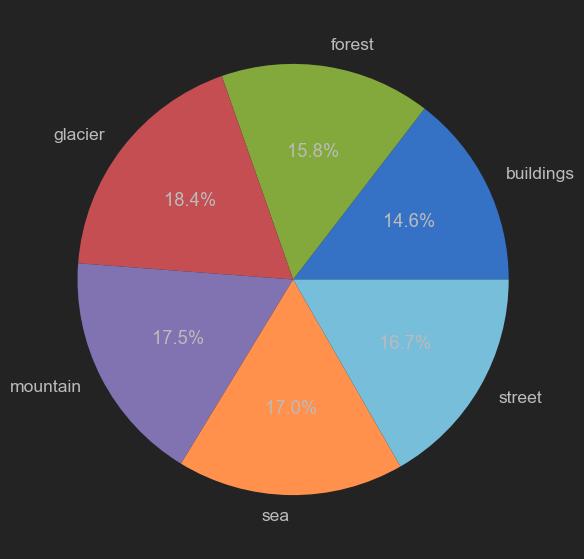

In [16]:
fig2, ax2 = plt.subplots()
ax2.pie(No_images_per_class, labels = Class_name1, autopct = '%1.1f%%')
plt.show

# PERFORMING DATA AUGMENTATION AND CREATE DATA GENERATOR

In [17]:
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        validation_split=0.15,
        horizontal_flip=True)
test_datagen = ImageDataGenerator(rescale=1./255)

In [18]:
train_generator = train_datagen.flow_from_directory(
        r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='training')

validation_generator = train_datagen.flow_from_directory(
       r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='validation')

test_generator = test_datagen.flow_from_directory(
       r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical')

Found 11932 images belonging to 6 classes.
Found 2102 images belonging to 6 classes.
Found 3000 images belonging to 6 classes.


In [19]:
#tf.keras.preprocessing.image.ImageDataGenerator(
      #featurewise_center=False,
      #samplewise_center=False,
      #featurewise_std_normalization=False,
      #samplewise_std_normalization=False,
      #zca_whitening=False,
      #zca_epsilon=1e-06,
      #rotation_range=0,
      #width_shift_range=0.0,
      #height_shift_range=0.0,
      #brightness_range=None,
      #shear_range=0.0,
      #zoom_range=0.0,
      #channel_shift_range=0.0,
      #fill_mode="nearest",
      #cval=0.0,
      #horizontal_flip=False,
      #vertical_flip=False,
      #rescale=None,
      #preprocessing_function=None,
      #data_format=None,
      #validation_split=0.3,
      #dtype=None)

In [20]:
train_generator = train_datagen.flow_from_directory(
        r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='training')

validation_generator = train_datagen.flow_from_directory(
       r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_train\seg_train',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical',
        subset ='validation')

test_generator = test_datagen.flow_from_directory(
       r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test',
        target_size=(256, 256),
        batch_size=32,
        class_mode='categorical')

Found 11932 images belonging to 6 classes.
Found 2102 images belonging to 6 classes.
Found 3000 images belonging to 6 classes.


# BUILDING THE RESNET MODEL

In [21]:
def res_block(X, filter, stage):
  X_copy = X
  f1 , f2, f3 = filter
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_conv_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = MaxPool2D((2,2))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_a')(X)
  X = Activation('relu')(X) 
  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_conv_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_b')(X)
  X = Activation('relu')(X) 
  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_conv_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_c')(X)
  X_copy = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_conv_copy', kernel_initializer= glorot_uniform(seed = 0))(X_copy)
  X_copy = MaxPool2D((2,2))(X_copy)
  X_copy = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_conv_copy')(X_copy)
  X = Add()([X,X_copy])
  X = Activation('relu')(X)
  X_copy = X
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_identity_1_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_a')(X)
  X = Activation('relu')(X) 
  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_identity_1_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_b')(X)
  X = Activation('relu')(X) 
  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_identity_1_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_1_c')(X)
  X = Add()([X,X_copy])
  X = Activation('relu')(X)
  X_copy = X
  X = Conv2D(f1, (1,1),strides = (1,1), name ='res_'+str(stage)+'_identity_2_a', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_a')(X)
  X = Activation('relu')(X) 
  X = Conv2D(f2, kernel_size = (3,3), strides =(1,1), padding = 'same', name ='res_'+str(stage)+'_identity_2_b', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_b')(X)
  X = Activation('relu')(X) 
  X = Conv2D(f3, kernel_size = (1,1), strides =(1,1),name ='res_'+str(stage)+'_identity_2_c', kernel_initializer= glorot_uniform(seed = 0))(X)
  X = BatchNormalization(axis =3, name = 'bn_'+str(stage)+'_identity_2_c')(X)
  X = Add()([X,X_copy])
  X = Activation('relu')(X)

  return X

In [22]:
input_shape = (256,256,3)
X_input = Input(input_shape)
X = ZeroPadding2D((3,3))(X_input)
X = Conv2D(64, (7,7), strides= (2,2), name = 'conv1', kernel_initializer= glorot_uniform(seed = 0))(X)
X = BatchNormalization(axis =3, name = 'bn_conv1')(X)
X = Activation('relu')(X)
X = MaxPooling2D((3,3), strides= (2,2))(X)
X = res_block(X, filter= [64,64,256], stage= 2)
X = res_block(X, filter= [128,128,512], stage= 3)
X = res_block(X, filter= [256,256,1024], stage= 4)
X = res_block(X, filter= [512,512,2048], stage= 5)
X = AveragePooling2D((2,2), name = 'Averagea_Pooling')(X)
X = Flatten()(X)
X = Dense(6, activation = 'softmax', name = 'Dense_final', kernel_initializer= glorot_uniform(seed=0))(X)
model = Model( inputs= X_input, outputs = X, name = 'Resnet18')
model.summary()

Model: "Resnet18"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 262, 262, 3)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1 (Conv2D)              (None, 128, 128, 64)         9472      ['zero_padding2d[0][0]']      
                                                                                                  
 bn_conv1 (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1[0][0]']        

# Training and compiling the deep learning model

In [23]:
optimizer = SGD(learning_rate=0.01, momentum = 0.9)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [24]:
earlystopping = EarlyStopping(monitor='val_accuracy', mode='min', verbose=1, patience=25)
checkpointer = ModelCheckpoint(filepath="weights.h5", verbose=1, save_best_only=True)

In [25]:
#history = model.fit(train_generator, steps_per_epoch= train_generator.n // 32, epochs = 100, validation_data= validation_generator, validation_steps= validation_generator.n // 32, callbacks=[checkpointer , earlystopping])

In [26]:
model.save('./xai.h5')

C:\Users\pande\anaconda3\Lib\site-packages\keras\src\engine\training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [27]:
pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [28]:
model.load_weights('./weights.h5')

# ASSESS THE PERFORMANCE OF THE TRAINED MODEL

In [29]:
print('Train loss & accuracy:', model.evaluate(train_generator))
print('\n')
print('Test loss & accuracy:', model.evaluate(test_generator))

373/373 [==============================] - 270s 724ms/step - loss: 0.1954 - accuracy: 0.9320
Train loss & accuracy: [0.19535845518112183, 0.932031512260437]


94/94 [==============================] - 41s 436ms/step - loss: 0.4298 - accuracy: 0.8590
Test loss & accuracy: [0.42981913685798645, 0.859000027179718]


In [30]:
labels = {0: 'buildings', 1: 'forest', 2: 'glacier', 3:'mountain', 4: 'sea', 5:'street'}

In [31]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
prediction = []
original = []
image = []
count = 0
for i in os.listdir(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test'):
  for item in os.listdir(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test', i)):
    img= PIL.Image.open(os.path.join(r'C:\Users\pande\OneDrive\Documents\Explainable AI\seg_test\seg_test', i, item))
    img = img.resize((256, 256))
    image.append(img)
    img = np.asarray(img, dtype = np.float32)
    img = img / 255
    img = img.reshape(-1, 256, 256, 3)
    predict = model.predict(img)
    predict = np.argmax(predict)
    prediction.append(labels[predict])
    original.append(i)


1/1 [==============================] - 0s 55ms/step


In [32]:
score = accuracy_score(original, prediction)
print("Test Accuracy : {}".format(score))

Test Accuracy : 0.861


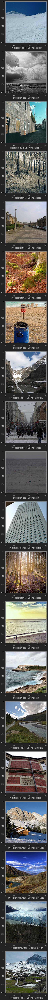

In [33]:
import random
fig = plt.figure(figsize = (100,100))
for i in range(20):
    j = random.randint(0, len(image))
    fig.add_subplot(20, 1, i+1)
    plt.xlabel("Prediction: " + prediction[j] +"   Original: " + original[j])
    plt.imshow(image[j])
fig.tight_layout()
plt.show()

In [34]:
print(classification_report(np.asarray(prediction), np.asarray(original)))

              precision    recall  f1-score   support

   buildings       0.87      0.80      0.83       473
      forest       0.95      0.98      0.96       456
     glacier       0.73      0.89      0.80       452
    mountain       0.88      0.79      0.83       585
         sea       0.92      0.87      0.90       535
      street       0.85      0.86      0.85       499

    accuracy                           0.86      3000
   macro avg       0.86      0.86      0.86      3000
weighted avg       0.87      0.86      0.86      3000



Text(0.5, 1.0, 'Confusion_matrix')

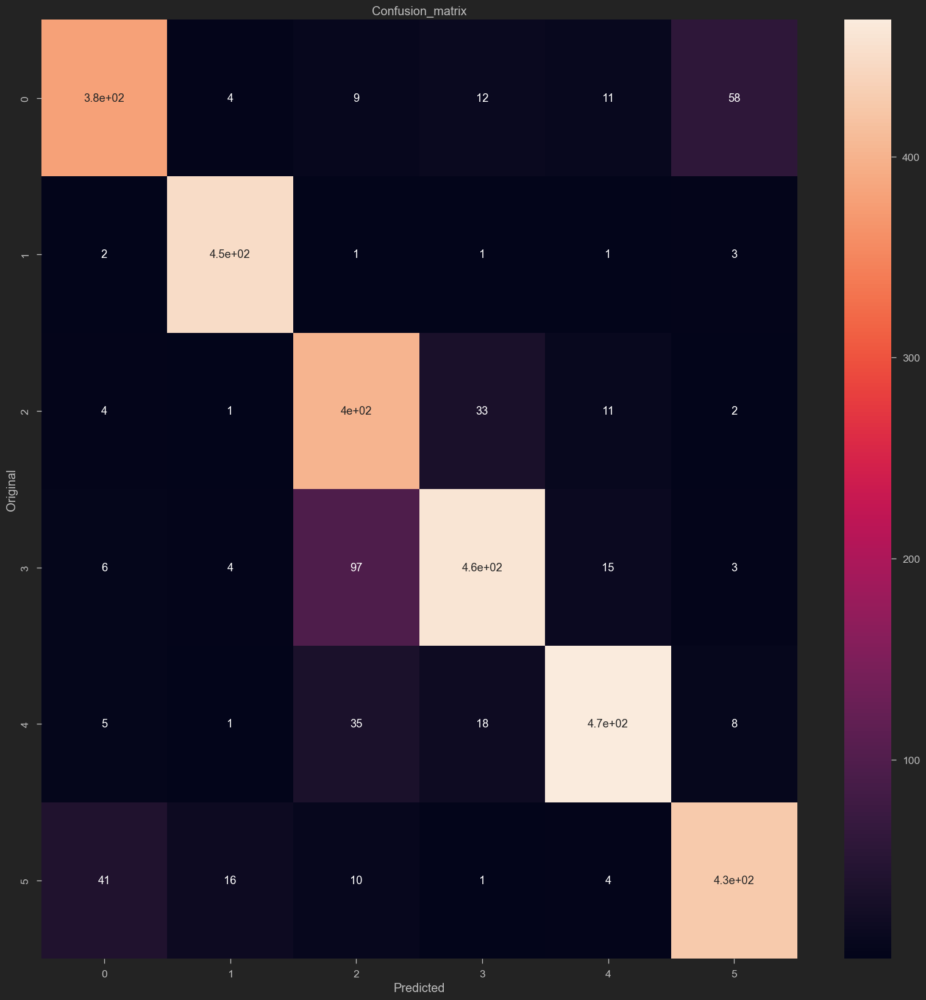

In [35]:
plt.figure(figsize=(20,20))
cm = confusion_matrix(np.asarray(prediction), np.asarray(original))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax)

ax.set_xlabel('Predicted')
ax.set_ylabel('Original')
ax.set_title('Confusion_matrix')


# Visualizing Activation Maps Through GRAD-CAM

In [36]:
def grad_cam(img):
  img = np.asarray(img, dtype = np.float32)
  img = img.reshape(-1, 256, 256, 3)
  img_scaled = img / 255
  classification_layers = ["Averagea_Pooling", "Dense_final"]
  final_conv = model.get_layer("res_5_identity_2_c")
  final_conv_model = keras.Model(model.inputs, final_conv.output)
  classification_input = keras.Input(shape = final_conv.output.shape[1:])
  temp = classification_input
  for layer in classification_layers:
      temp = model.get_layer(layer)(temp)
  classification_model = keras.Model(classification_input, temp)
  with tf.GradientTape() as tape:
      final_conv_output = final_conv_model(img_scaled)
      tape.watch(final_conv_output)
      prediction = classification_model(final_conv_output)
      predicted_class = tf.argmax(prediction[0][0][0])
      predicted_class_value = prediction[:,:,:,predicted_class]
  gradient = tape.gradient(predicted_class_value, final_conv_output)
  gradient_channels = tf.reduce_mean(gradient, axis=(0, 1, 2))
  final_conv_output = final_conv_output.numpy()[0]
  gradient_channels = gradient_channels.numpy()
  for i in range(gradient_channels.shape[-1]):
      final_conv_output[:, :, i] *= gradient_channels[i]
  heatmap = np.mean(final_conv_output, axis=-1)
  heatmap_normalized = np.maximum(heatmap, 0) / np.max(heatmap)
  heatmap = np.uint8(255 * heatmap_normalized )
  color_map = plt.cm.get_cmap('jet')
  color_map = color_map(np.arange(256))[:, :3]
  heatmap = color_map[heatmap]
  heatmap = keras.preprocessing.image.array_to_img(heatmap)
  heatmap = heatmap.resize((256, 256))
  heatmap = np.asarray(heatmap, dtype = np.float32)
  final_img = heatmap * 0.4 + img[0]
  final_img = keras.preprocessing.image.array_to_img(final_img)

  return final_img, heatmap_normalized

C:\Users\pande\AppData\Local\Temp\ipykernel_5556\3002629160.py:28: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = plt.cm.get_cmap('jet')


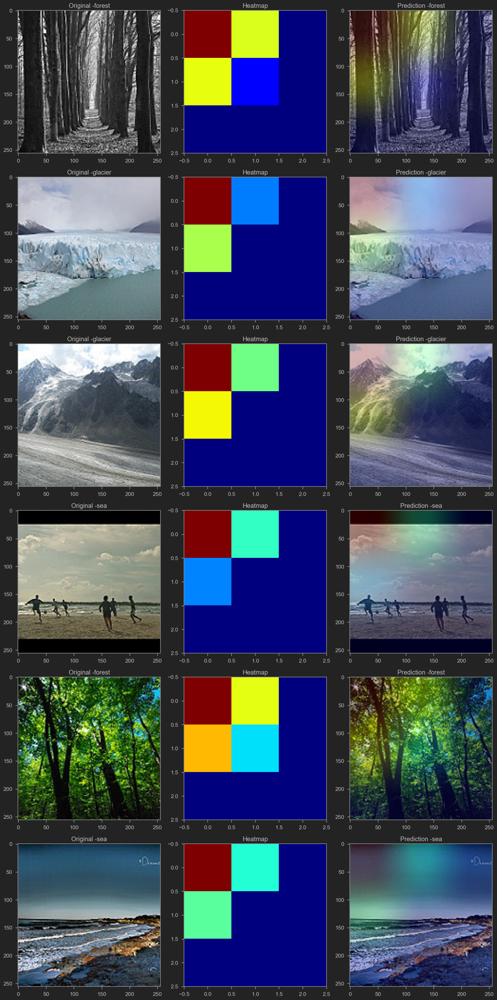

In [38]:
import random
import matplotlib.pyplot as plt

fig, axs = plt.subplots(6, 3, figsize=(16, 32))
count = 0
for _ in range(6):
    i = random.randint(0, len(image) - 1)  # Fix to avoid IndexError
    gradcam, heatmap = grad_cam(image[i])
    
    axs[count][0].title.set_text("Original -" + original[i])
    axs[count][0].imshow(image[i])
    
    axs[count][1].title.set_text("Heatmap")
    axs[count][1].imshow(heatmap, cmap=plt.get_cmap('jet'))  
    
    axs[count][2].title.set_text("Prediction -" + prediction[i])
    axs[count][2].imshow(gradcam)
    
    count += 1

fig.tight_layout()
